In [1]:
from PIL import Image
from torchvision import models, transforms
import torchvision
import torch
import torch.nn as nn
from torchvision.transforms import Compose, Lambda
from torchvision.transforms._transforms_video import (
    CenterCropVideo,
    NormalizeVideo,
)
from pytorchvideo.data.encoded_video import EncodedVideo
from pytorchvideo.transforms import (
    ApplyTransformToKey,
    ShortSideScale,
    UniformTemporalSubsample,
    UniformCropVideo
)
import numpy as np

c:\Users\Fastora\AppData\Local\Programs\Python\Python310\lib\site-packages\torchvision\transforms\_functional_video.py:6: UserWarning: The 'torchvision.transforms._functional_video' module is deprecated since 0.12 and will be removed in the future. Please use the 'torchvision.transforms.functional' module instead.
  warnings.warn(
c:\Users\Fastora\AppData\Local\Programs\Python\Python310\lib\site-packages\torchvision\transforms\_transforms_video.py:22: UserWarning: The 'torchvision.transforms._transforms_video' module is deprecated since 0.12 and will be removed in the future. Please use the 'torchvision.transforms' module instead.
  warnings.warn(
c:\Users\Fastora\AppData\Local\Programs\Python\Python310\lib\site-packages\torchvision\transforms\functional_tensor.py:5: UserWarning: The torchvision.transforms.functional_tensor module is deprecated in 0.15 and will be **removed in 0.17**. Please don't rely on it. You probably just need to use APIs in torchvision.transforms.functional or in

In [2]:
# video_path = "recipe1.mp4"
# video = EncodedVideo.from_path(video_path)

# #get first 100 seconds
# video_data = video.get_clip(start_sec=0, end_sec=100)

# print(
#     "video info: \n",
#     f"name: {video.name}\n",
#     f"duration: {video.duration}",
# )


In [3]:
# torchvision.set_video_backend("video_reader")
# stream = "video"
# video1 = torchvision.io.read_video(video_path, stream)
# video1.get_meta_data()

In [4]:
# working_video = video_data
# mean = [0.45, 0.45, 0.45]
# std = [0.225, 0.225, 0.225]
# frames_per_second = 30
# transform =  ApplyTransformToKey(
#     key="video",
#     transform=Compose(
#         [
#             UniformTemporalSubsample(16),
#             Lambda(lambda x: x/255.0),
#             NormalizeVideo(mean, std),
#             ShortSideScale(size=256),
#             CenterCropVideo(
#                 crop_size=(256, 256)
#             )
#         ]
#     ),
# )
# working_video = transform(working_video)

In [5]:
# import cv2
# vidcap = cv2.VideoCapture('recipe1.mp4')
# success,image = vidcap.read()
# count = 0
# #write a frame every 5
# while success:
#     if count % 500 == 0:
#         #make frame 512x512
#         image = cv2.resize(image, (512, 512))
#         cv2.imwrite("frames/frame%d.jpg" % count, image)     # save frame as JPEG file      
#     success,image = vidcap.read()
#     count += 1


In [6]:
rn18 = models.resnet18(pretrained=True)

c:\Users\Fastora\AppData\Local\Programs\Python\Python310\lib\site-packages\torchvision\models\_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
c:\Users\Fastora\AppData\Local\Programs\Python\Python310\lib\site-packages\torchvision\models\_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=ResNet18_Weights.IMAGENET1K_V1`. You can also use `weights=ResNet18_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


In [7]:

class new_model(nn.Module):
    def __init__(self,output_layer = None):
        super().__init__()
        self.pretrained = models.resnet18(pretrained=True)
        self.output_layer = output_layer
        self.layers = list(self.pretrained._modules.keys())
        self.layer_count = 0
        for l in self.layers:
            if l != self.output_layer:
                self.layer_count += 1
            else:
                break
        for i in range(1,len(self.layers)-self.layer_count):
            self.dummy_var = self.pretrained._modules.pop(self.layers[-i])
        
        self.net = nn.Sequential(self.pretrained._modules)
        self.pretrained = None

    def forward(self,x):
        x = self.net(x)
        return x

In [8]:
model = new_model(output_layer='layer4')
model.eval()

new_model(
  (pretrained): None
  (dummy_var): AdaptiveAvgPool2d(output_size=(1, 1))
  (net): Sequential(
    (conv1): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
    (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (relu): ReLU(inplace=True)
    (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
    (layer1): Sequential(
      (0): BasicBlock(
        (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
        (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (relu): ReLU(inplace=True)
        (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
        (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      )
      (1): BasicBlock(
        (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
  

In [9]:
import os
images = []
#open frames folder and read in images
#sort frames by name
for filename in sorted(os.listdir('frames')):
    img = Image.open('frames/' + filename)
    images.append(img)


In [10]:
preprocess = transforms.Compose([
        transforms.Resize(256),
        transforms.CenterCrop(224),
        transforms.ToTensor(),
        transforms.Normalize(
        mean=[0.485, 0.456, 0.406],
        std=[0.229, 0.224, 0.225]
    )])

In [11]:
images_processed = []
image_names = [x.filename.split("/")[1] for x in images]
#sort images_names by frame number in name frame#.jpg
image_names = [int(x.split(".")[0].split("frame")[1]) for x in image_names]


#sort images by name
images = [x for _,x in sorted(zip(image_names,images))]


for image in images:
    images_processed.append(preprocess(image))
    

In [12]:
images_processed = torch.stack(images_processed)
images_processed = images_processed.unsqueeze(0)



In [13]:
output  = []
for image in images_processed:
    output.append(model(image))


In [14]:
output = output[0]

In [15]:
import matplotlib.pyplot as plt
#import cosine similarity from sklearn
from sklearn.metrics.pairwise import cosine_similarity
#for each 2 images 
#display the original 2 images

# for i in range(0, len(output)-1):
#     #display the 2 images next to each other
#     fig, (ax1, ax2) = plt.subplots(1, 2)
#     ax1.imshow(images[i])
#     ax2.imshow(images[i+1])
#     #get output of the 2 images
#     output1 = output[i].detach().numpy()
#     output2 = output[i+1].detach().numpy()
#     #get cosine similarity
#     cos_sim = cosine_similarity(output1.reshape(1, -1), output2.reshape(1, -1))
#     #add cosine similarity to the title
#     fig.suptitle("Cosine Similarity: " + str(cos_sim[0][0]))
    
   

#     plt.show()


    

c:\Users\Fastora\AppData\Local\Programs\Python\Python310\lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


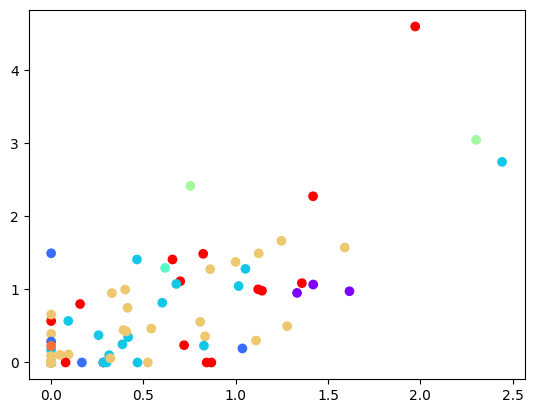

In [19]:
#from sklean import clusering
from sklearn.cluster import KMeans
k_outs = output.detach().numpy()
k_outs = k_outs.reshape(k_outs.shape[0], -1)
#use kmeans to cluster the images into steps
kmeans = KMeans(n_clusters=5, random_state=0).fit(k_outs)
#visualize the clusters
plt.scatter(k_outs[:, 0], k_outs[:, 1], c=kmeans.labels_, cmap='rainbow')





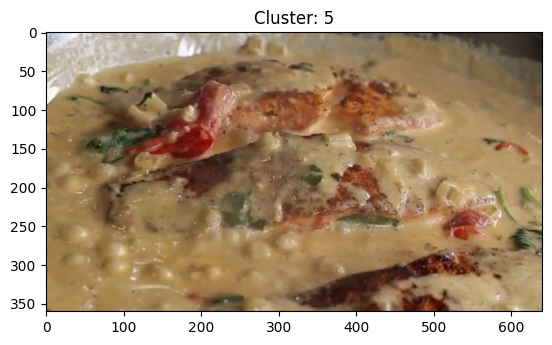

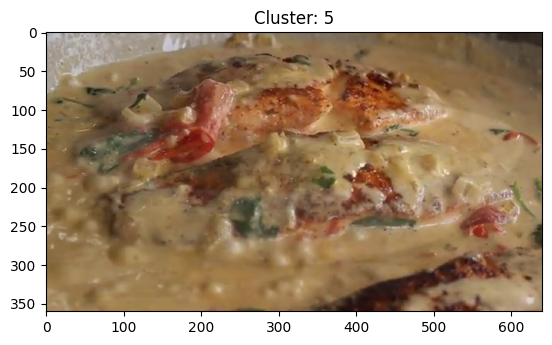

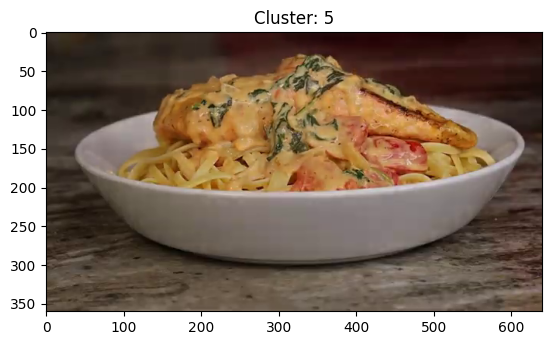

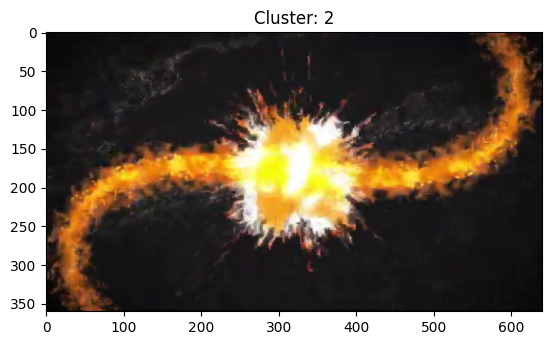

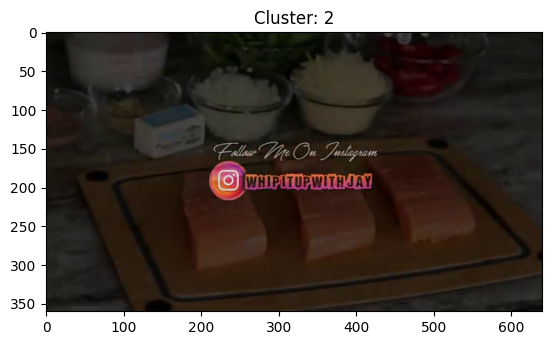

...

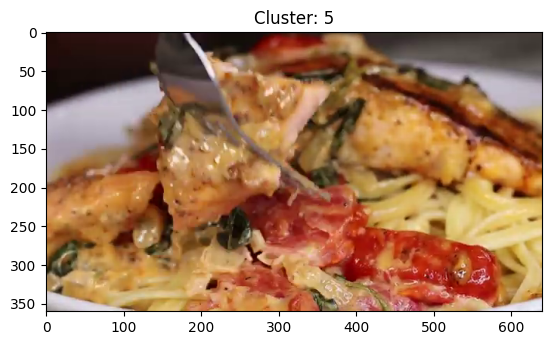

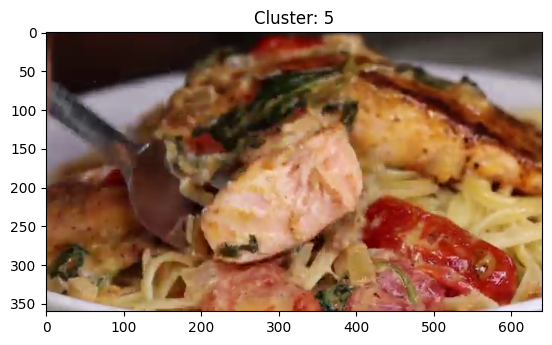

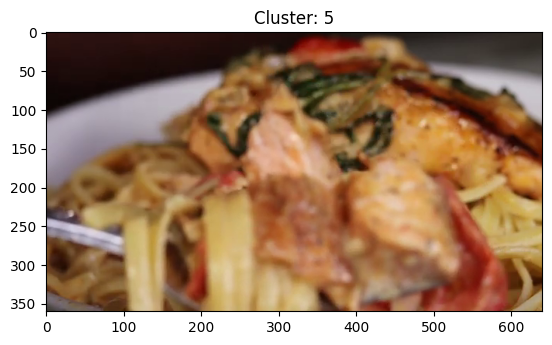

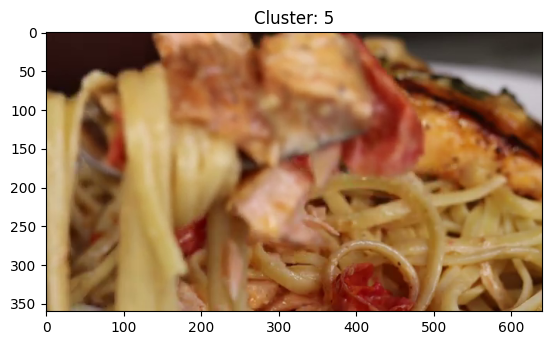

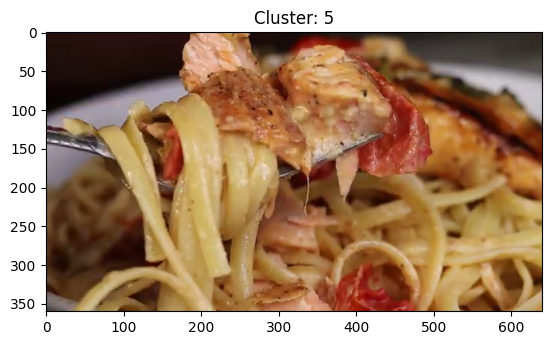

In [20]:
#display the images in each cluster and annotate the cluster number
for i in range(0, len(kmeans.labels_)):
    #display images in cluster and annotate cluster number in title
    plt.imshow(images[i])
    plt.title("Cluster: " + str(kmeans.labels_[i]))
    plt.show()
    

    
